# Load computation results to a [DataBase](../isf_data_base/isf_data_base.py) for further analysis

In [ ]:
import Interface as I
from getting_started import getting_started_dir
client = I.get_client()
db = I.DataBase('{}/labs/getting_started_db/'.format(I.os.environ['HOME']))

This gives convenient access to the data using the widely used pandas and dask libraries. It also converts the data to an optimized binary format (parquet, also the synapse and cell activation data is categorized, i.e. repeated values are replaced by an integer). This gives the following advantages:
  - reduced space on harddisk (25% of original data)
  - fast access

In [ ]:
I.db_init_simrun_general.init(db, db['simrun'], client=client)

[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


load dask dataframe with known divisions
[WARNING] isf_data_base: The database source folder has uncommitted changes!


[WARNING] isf_data_base: The database source folder has uncommitted changes!


load dask dataframe with known divisions
[WARNING] utils: Converting the following column names to string for saving with parquet: Int64Index([0], dtype='int64')


[WARNING] isf_data_base: The database source folder has uncommitted changes!


load dask dataframe with known divisions
[WARNING] utils: Converting the following column names to string for saving with parquet: Int64Index([0, 1, 2, 3, 4, 5, 6, 7], dtype='int64')


[WARNING] isf_data_base: The database source folder has uncommitted changes!


Now, the following keys are set:

| Key | Description | Type |
|---|---|---|
| `synapse_activation` |activation of synapses for each simulationtrail | `dask.DataFrame` |
|`cell_activation`| activation of presynaptic cells for each simulationtrail| `dask.DataFrame`
|`voltage_traces`| soma voltage traces| `dask.DataFrame`
|`spike_times`| spike times| `pandas.DataFrame`
|`dendritic_recordings`| voltage traces on the dendrite as specified in the cell parameter file| `DataBase` containing a separate `dask.DataFrame` for every recording location
|`metadata`| original filenames| `pandas.DataFrame`
|`parameterfiles`| mapping between simulation trial and used parameter files| `pandas.DataFrame`
|`parameterfiles_cell_folder`| folder containing the cell parameter files| `ManagedFolder`
|`parameterfiles_network_folder`| folder containing the network parameterfiles| `ManagedFolder`
|`sim_trail_index`| all simulation trials| `pandas.Series`
|`simresult_path`| original path from which the simulation has been loaded| `str`

Let's have a look at the synapse activation data frame:

In [ ]:
db['synapse_activation']

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=9,,,,,,,,,,,,,
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B2/results/20240129-1318_seed3128316070_pid193959/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240129-1318_seed2055378571_pid193935/000000,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_D3/results/20240129-1318_seed2055378571_pid193935/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This is a dask dataframe object. Instead of loading the data fully, it is a pointer to the actual data which is stored in the database using the parquet binary format. The data is split up into chunks of reasonable file size. 

Only when actual computations need to be done, are the values of the data loaded. Until then, it will only provide relevant metadata. Let's explicitly load a small fractin of the data to have a look:

In [ ]:
head = db['synapse_activation'].head(2)
head

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_B1,1,1401.270115,60,55,ApicalDendrite,0.727976,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_B1,2,1240.856446,51,165,ApicalDendrite,0.727976,NaN,NaN,NaN,NaN,NaN,NaN


We can select data using the index:

In [ ]:
some_index = db['synapse_activation'].compute().index[0]
db['synapse_activation'].loc[some_index]

load dask dataframe with known divisions
load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
npartitions=1,,,,,,,,,,,,,
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,object,int64,float64,int64,int64,object,float64,float64,float64,float64,float64,float64,float64
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,...,...,...,...,...,...,...,...,...,...,...,...,...


This returns a dask dataframe again; the query is not computed yet. To do this, call compute:

In [ ]:
# this prints out a table containing all synapse activations during the specified trail
db['synapse_activation'].loc[some_index].compute()

load dask dataframe with known divisions


,synapse_type,synapse_ID,soma_distance,section_ID,section_pt_ID,dendrite_label,0,1,2,3,4,5,6
sim_trail_index,,,,,,,,,,,,,
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_B1,1,1401.270115,60,55,ApicalDendrite,0.727976,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_B1,2,1240.856446,51,165,ApicalDendrite,0.727976,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_B1,5,1405.573629,71,29,ApicalDendrite,127.144433,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_C2,3,1378.348113,72,13,ApicalDendrite,180.359151,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,L1_C2,5,1496.336710,50,59,ApicalDendrite,160.976301,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,VPM_C2,156,308.177742,83,85,ApicalDendrite,61.816266,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,VPM_C2,208,493.842851,38,283,ApicalDendrite,266.153992,NaN,NaN,NaN,NaN,NaN,NaN
stim_B1/results/20240129-1318_seed1218629423_pid193949/000000,VPM_C2,246,93.402953,147,55,Dendrite,222.430696,NaN,NaN,NaN,NaN,NaN,NaN


What is the average distance of synapses from the soma by celltype?

In [ ]:
# load dask dataframe
sa = db['synapse_activation']
# assign a new column: the celltype is the first part of the synapse_type column
sa['celltype'] = sa.map_partitions(lambda x: x.synapse_type.str.split('_').str[0])
# groupb by this value, compute the mean soma distance in each group, compute the result on the cluster
sa.groupby('celltype').apply(lambda x: x.soma_distance.mean()).compute(scheduler=client)


`meta` is not specified, inferred from partial data. Please provide `meta` if the result is unexpected.
  Before: .apply(func)
  After:  .apply(func, meta={'x': 'f8', 'y': 'f8'}) for dataframe result
  or:     .apply(func, meta=('x', 'f8'))            for series result




load dask dataframe with known divisions


celltype
L56Trans      159.313973
L1           1396.392856
L4py          296.720456
L6ct          183.045651
SymLocal1    1159.475240
SymLocal6     151.661303
L4sp          498.829353
L45Sym        190.937973
L5tt          240.741090
SymLocal4     120.336174
L23Trans      918.617480
L45Peak       348.863928
L4ss          407.109462
L2            750.442501
SymLocal3     213.748406
SymLocal5     159.944820
VPM           266.652827
L34           505.450474
L5st          789.898382
L6cc          315.608998
L6ccinv       246.674604
SymLocal2     674.800147
dtype: float64

### Visualizing the simulation

It is easy to create an animation of a simulation trail from the database:

In [ ]:
cell = I.simrun_simtrail_to_cell_object(db, some_index)

In [ ]:
if not 'D3_stim_animation' in db.keys():
    I.cell_to_animation(cell, \
                        xlim = [0,1500], \
                        ylim = [-90, 50], \
                        tstart = 245-25, \
                        tend = 245+25, \
                        tstep = 0.2, \
                        outdir = db.create_managed_folder('D3_stim_animation'))
I.display_animation(db['D3_stim_animation'].join('*', '*png'), embedded = True)

Or to visualize the synapse activations on the postsynaptic cell.

[[-62.2448242409933], [-62.2448242409933, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.1847054464355, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -62.04142151637405, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.71243403865547, -61.712434038655


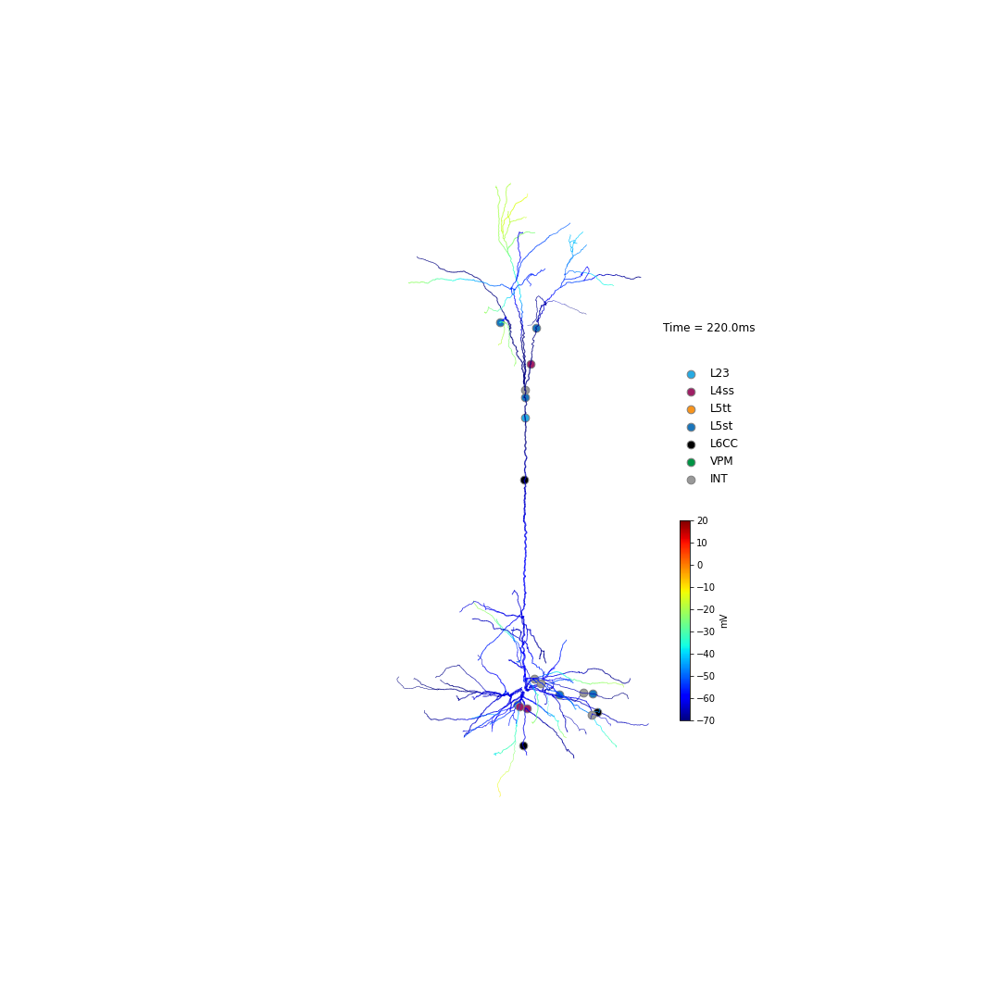
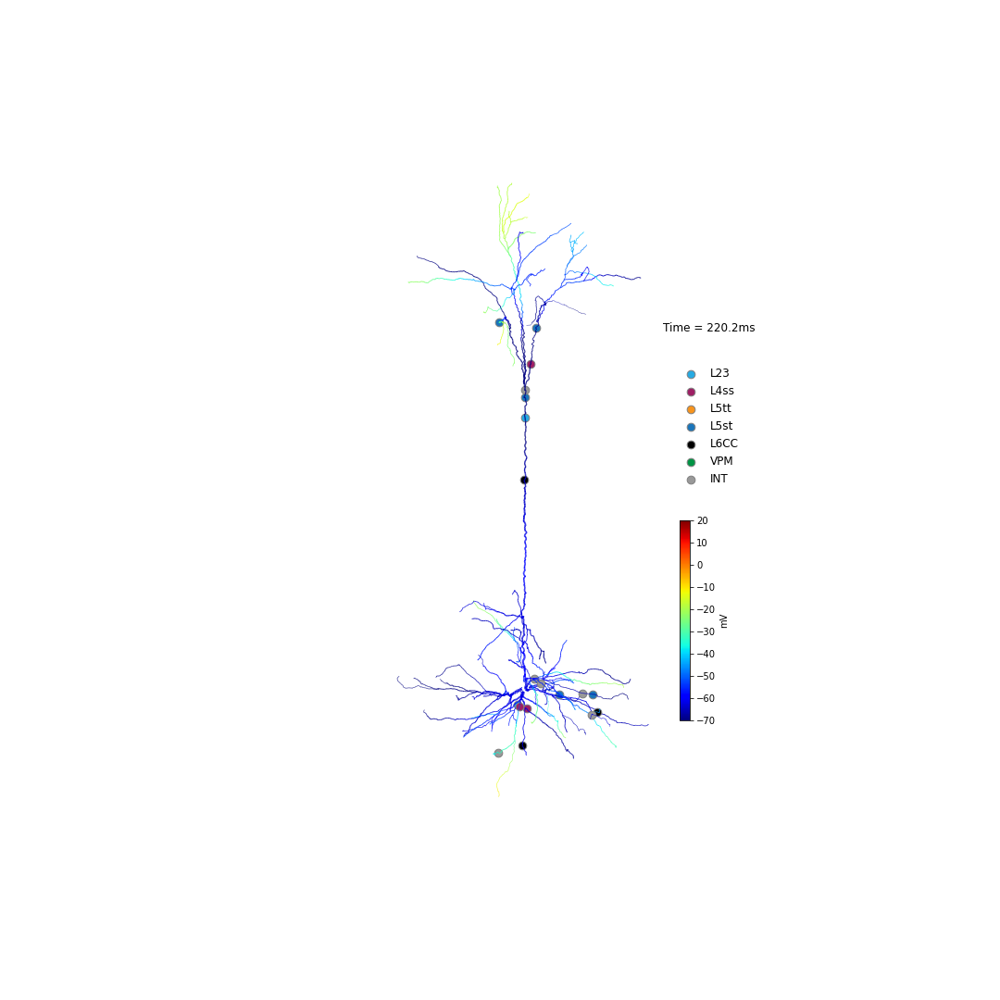
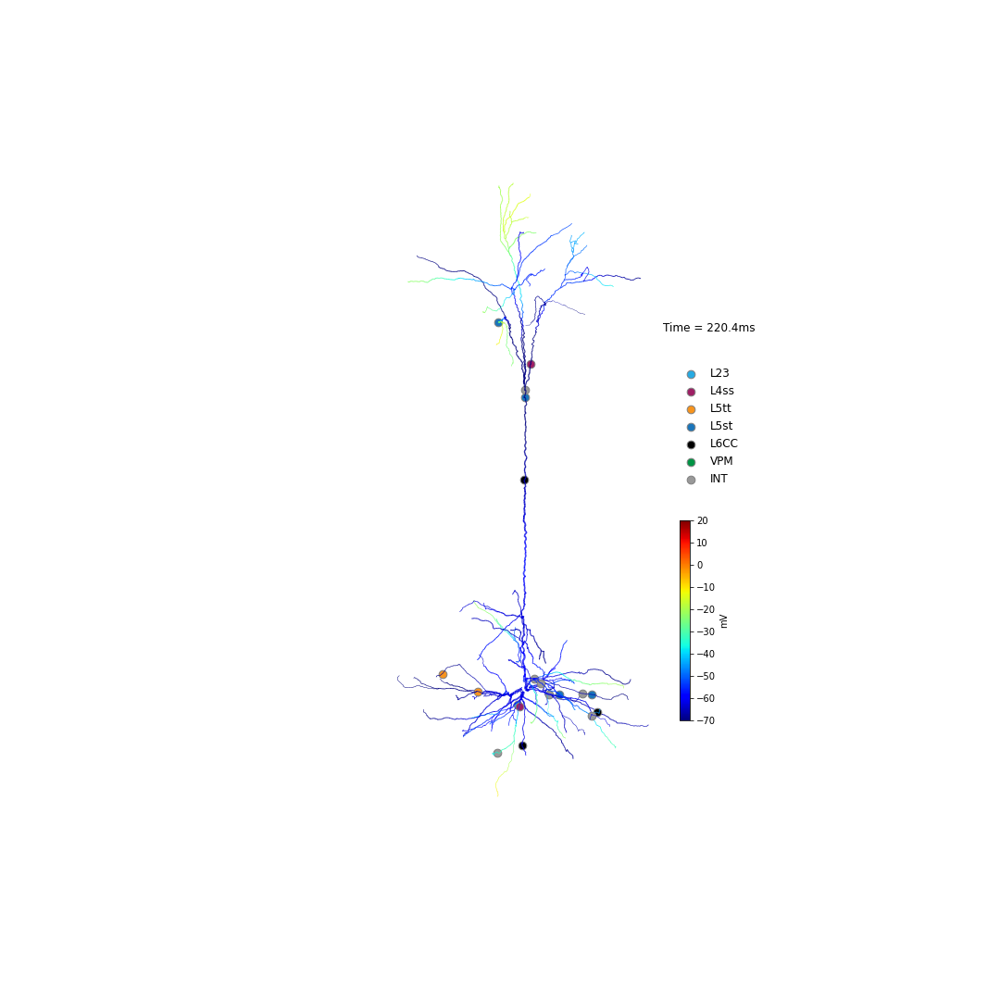
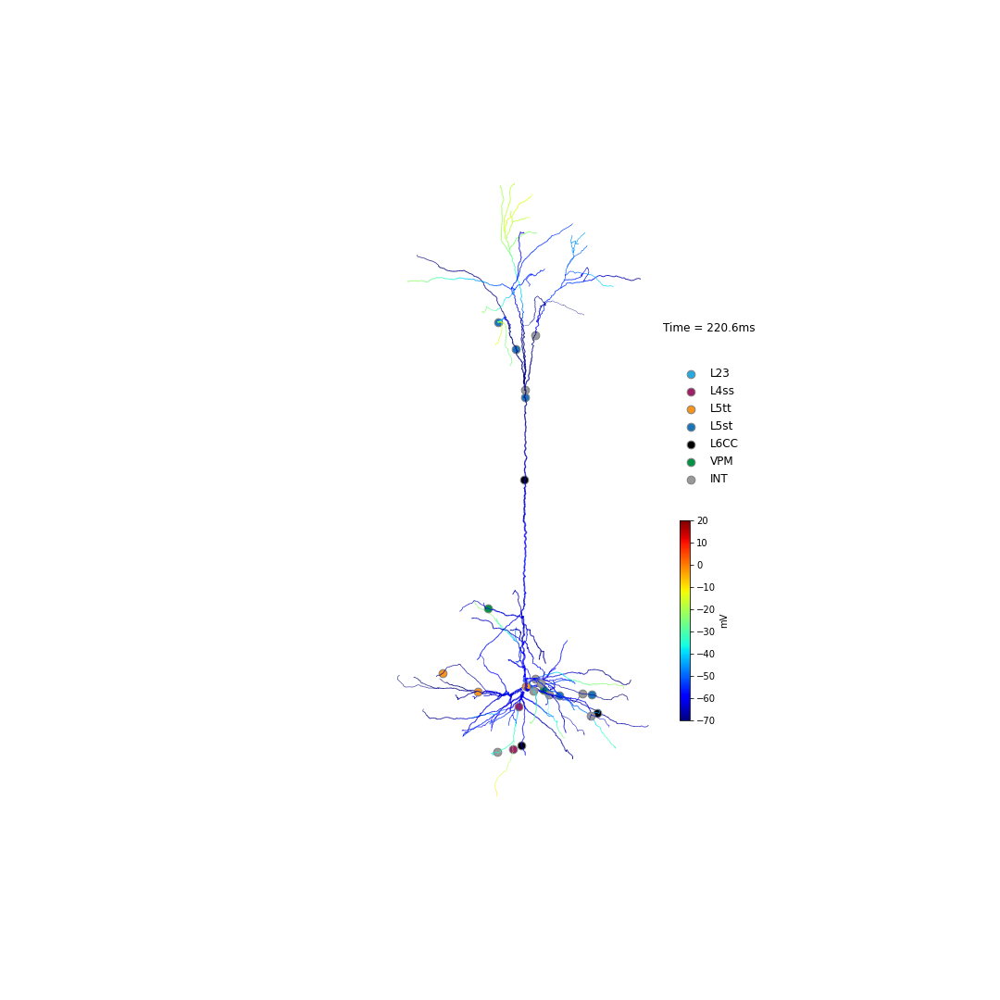
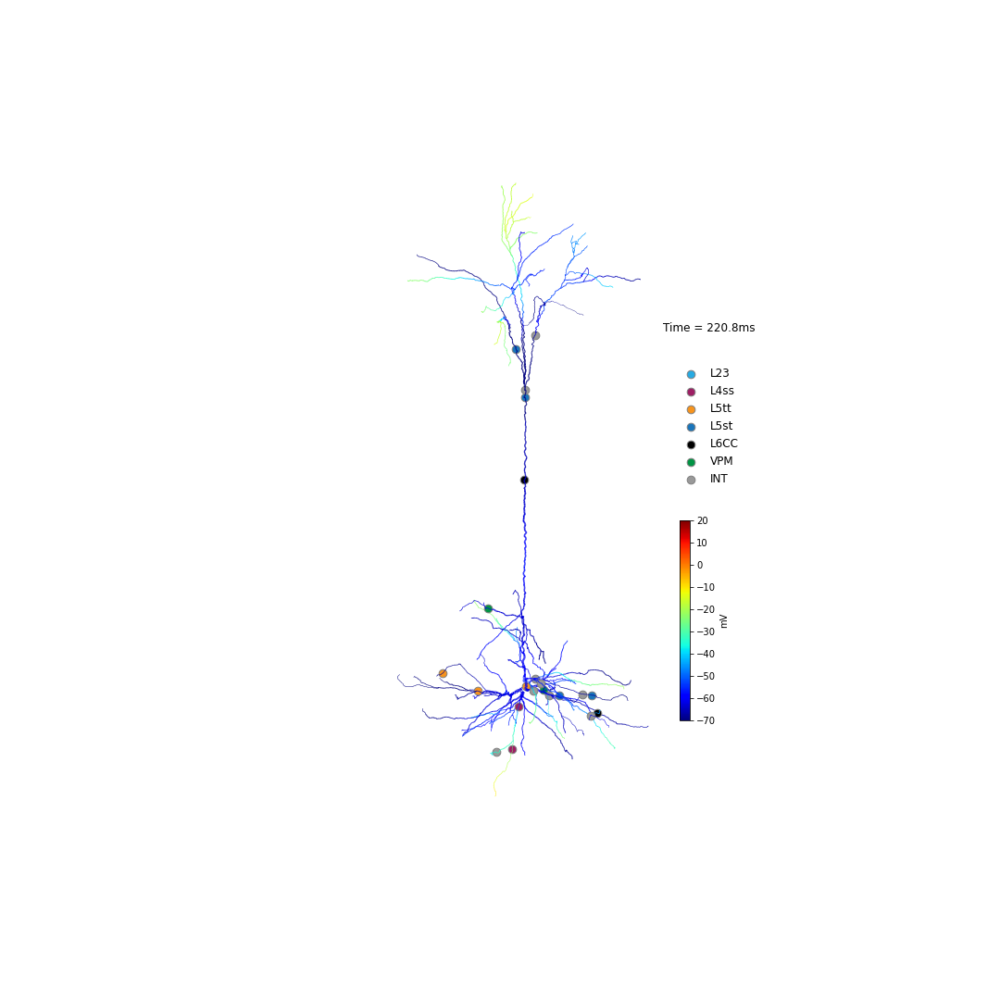
...
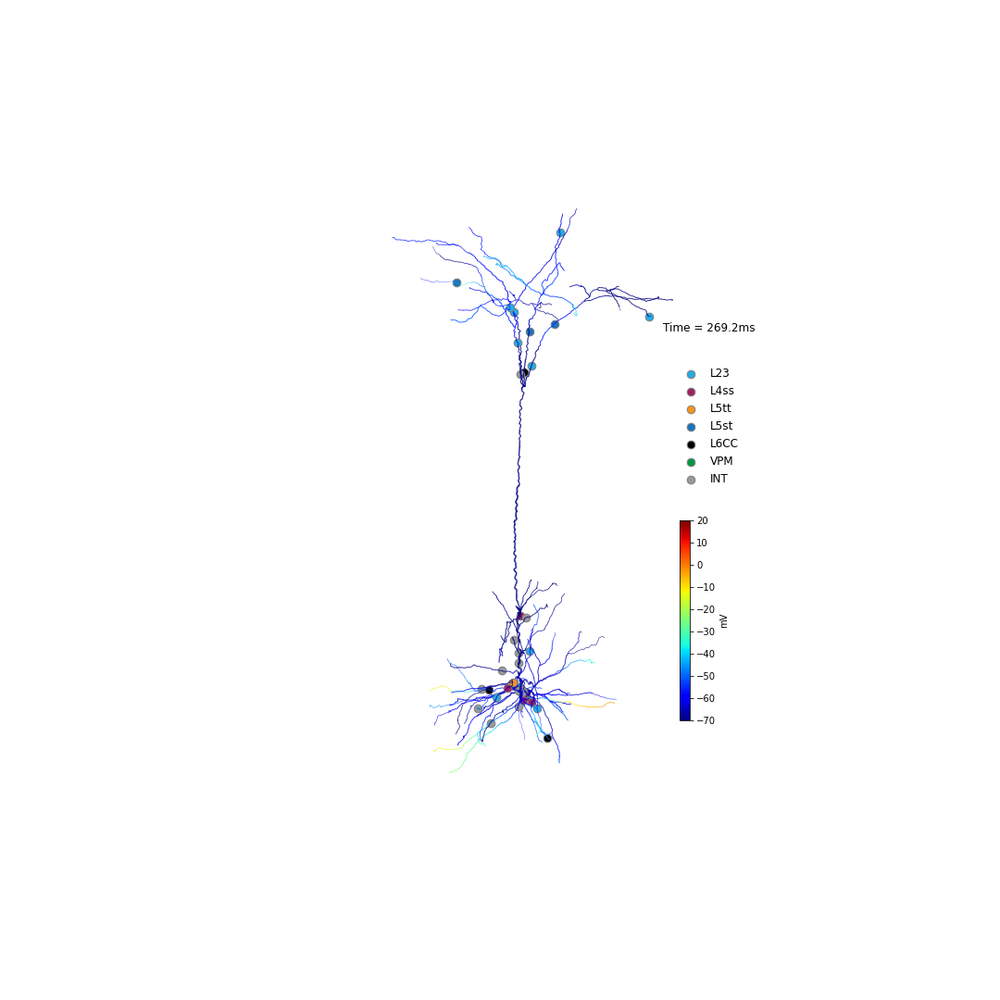
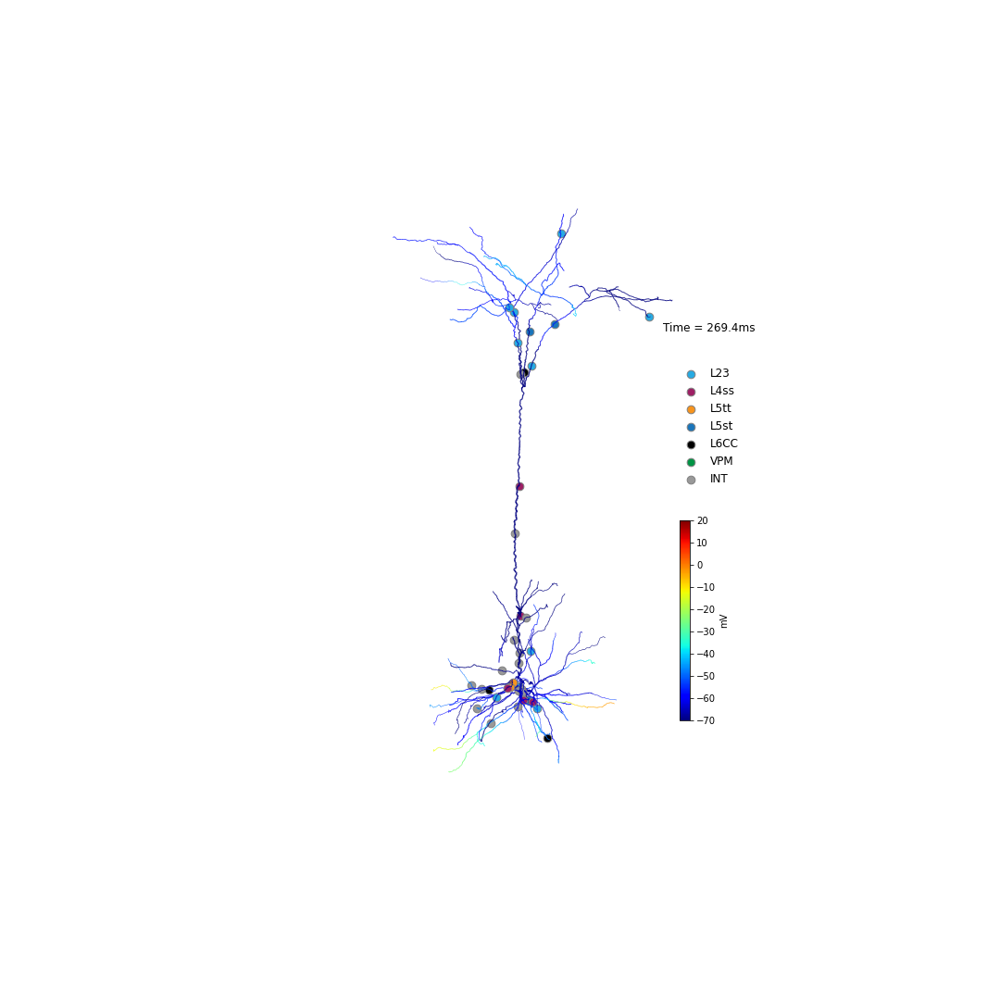
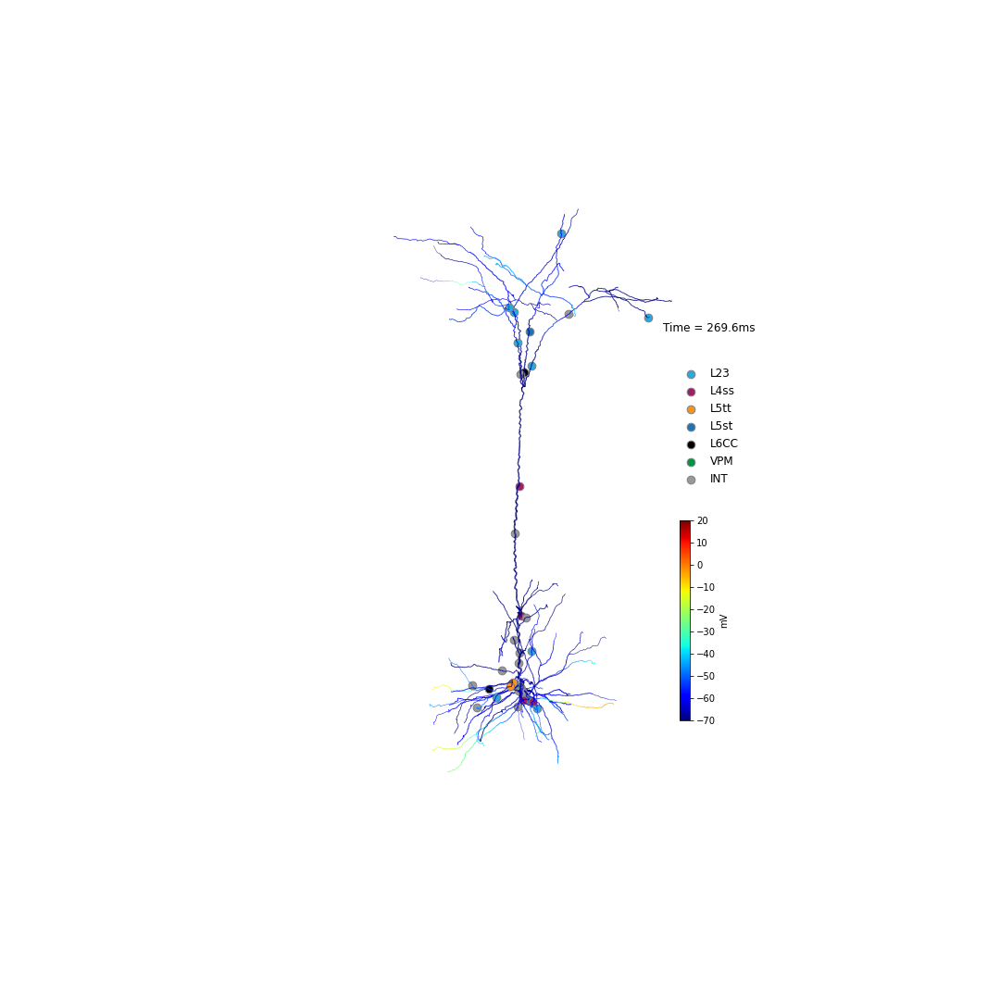
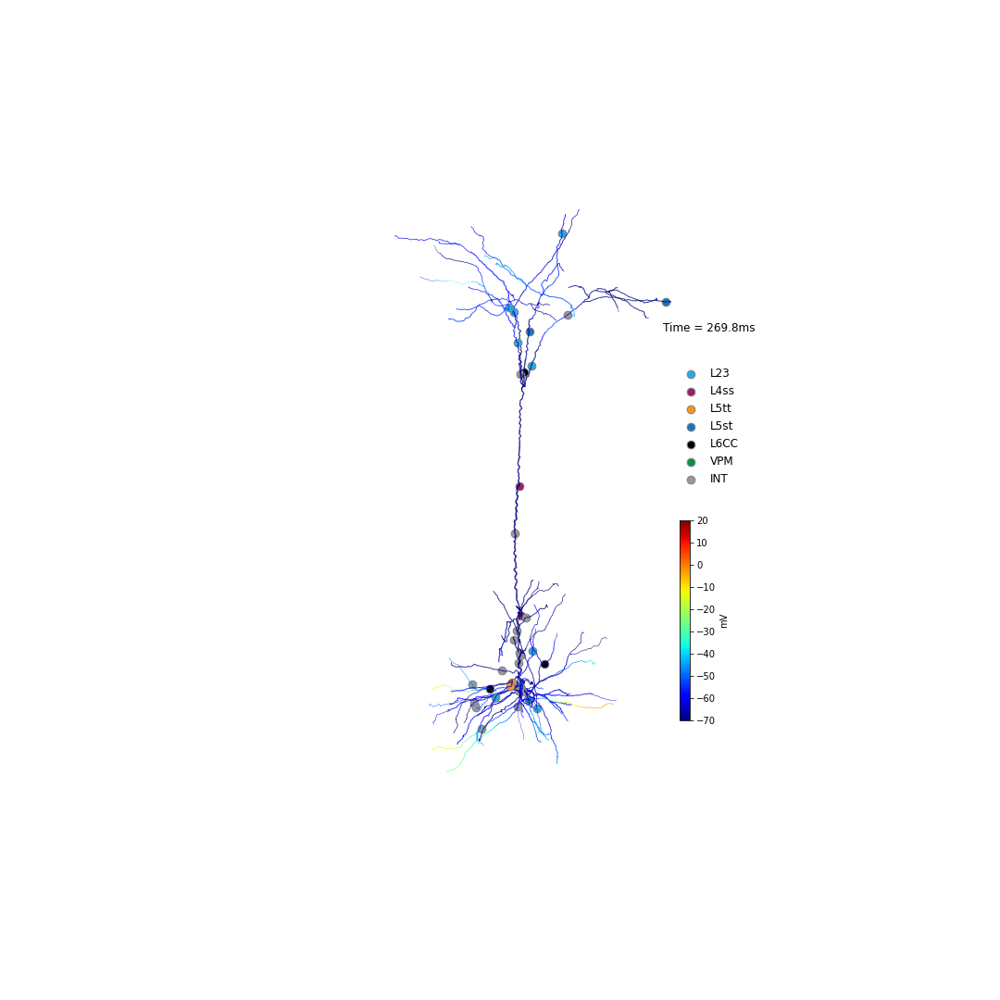
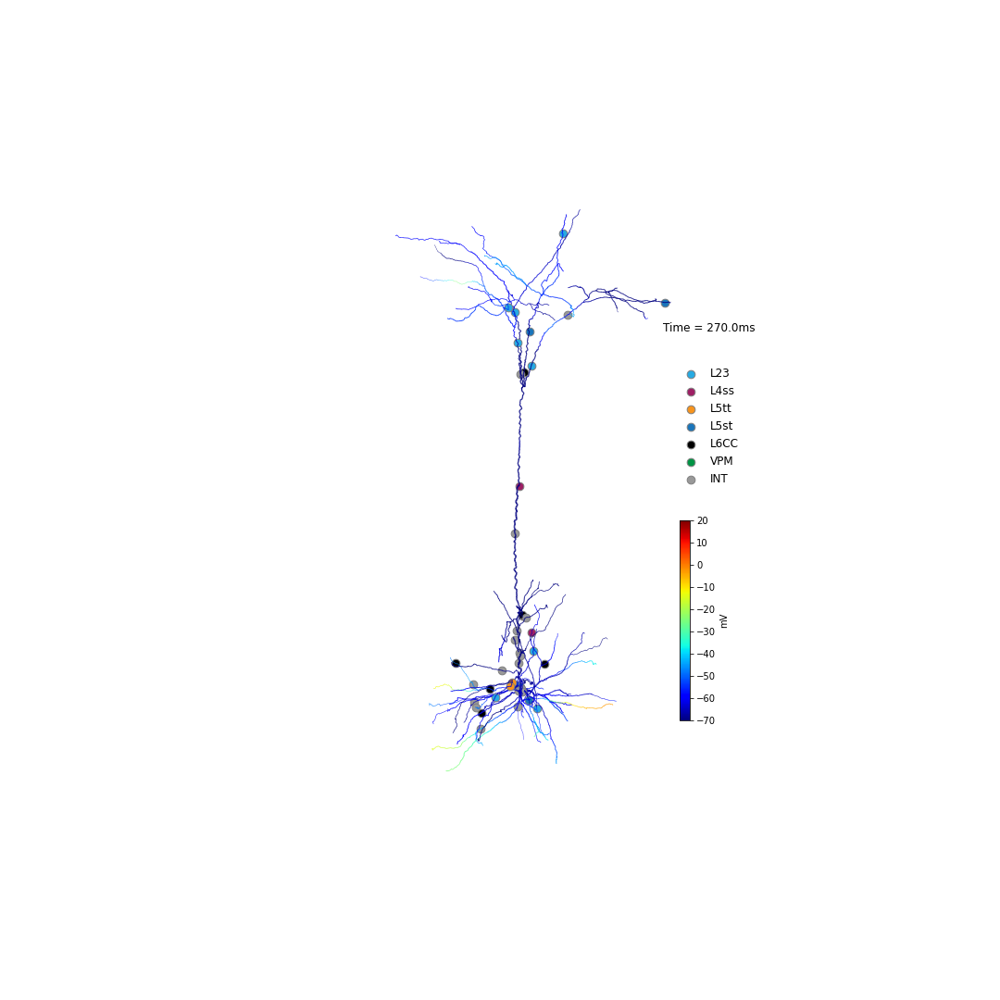

In [ ]:
from visualize.cell_morphology_visualizer import CellMorphologyVisualizer

# # To remake the visualization, uncomment this code
# if os.path.exists(db.basedir/'D3_stim_animation_3d'):
#     I.shutil.rmtree(db.basedir/'D3_stim_animation_3d')

cmv = CellMorphologyVisualizer(cell)
cmv.population_to_color_dict['inactive'] = "#f0f0f0"  # add color for inactive

images_path = str(db.basedir/'D3_stim_animation_3d')
cmv.display_animation_voltage_synapses_in_morphology_3d(
    images_path=images_path, 
    client=I.get_client(), 
    t_start=245-25, t_end=245+25, t_step=0.2)

You can even visualize the soma locations of the active presynaptic cells. 

As this requires 3D rendering, we are going to step out of python to visualize this. You can write out the postsynaptic cell and presynaptic locations as `.vtk` files: free, open-source and standardized. These can in principle be visualized in Python, but the rendering setup is a bit tedious. You can also use any rendering program that supports `.vtk`. We recommend Paraview.

In [ ]:
if not 'synapse_activation_vtk' in db.keys():
    db.create_managed_folder('synapse_activation_vtk')
db.ls()

Located at /gpfs/soma_fs/home/meulemeester/labs/getting_started_db
getting_started_db
├── cell_activation
├── voltage_traces
├── simresult_path
├── metadata
├── sim_trail_index
├── anatomical_constraints
├── parameterfiles
├── synapse_activation_vtk
├── filelist
├── spike_times
├── D3_stim_animation
├── simrun
├── dendritic_spike_times
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7_-30.0
├── dendritic_recordings
│   └── apical_proximal_distal_rec_sites_ID_000_sec_038_seg_032_x_0.929_somaDist_920.7
├── synapse_activation
├── parameterfiles_network_folder
├── biophysical_constraints
├── D3_stim_animation_3d
├── network_param
└── parameterfiles_cell_folder


Let's map the presynaptic cells to their corresponding location. The activation of presynaptic cells, including their celltype, is given in the DataBase key "cell_acativation". Their locations are saved in the "anatomical_constraints" key.

In [ ]:
from simrun2.utils import get_fraction_of_landmarkAscii_dir
soma_location_pdf = get_fraction_of_landmarkAscii_dir(1, db.basedir/'anatomical_constraints'/'presynaptic_somata')
soma_location_pdf

,positions,label
0,"(-162.9838, -42.69825, 667.4422)",presynaptic_somata_L1
1,"(-682.4518, 73.79571, 653.9649)",presynaptic_somata_L1
2,"(-265.098, 293.324, 626.5103)",presynaptic_somata_L1
3,"(156.8262, 540.524, 570.7275)",presynaptic_somata_L1
4,"(149.1849, -179.4385, 651.007)",presynaptic_somata_L1
...,...,...
19699,"(2411.94, -1420.78, 278.445)",presynaptic_somata_VPM
19700,"(2409.41, -1196.62, 138.844)",presynaptic_somata_VPM
19701,"(2469.08, -1530.03, 425.697)",presynaptic_somata_VPM
19702,"(2523.4, -1270.43, 240.496)",presynaptic_somata_VPM


In [ ]:
ca = db['cell_activation'].loc[some_index].compute()
ca['celltype'] = [e.split("_")[0] for e in ca['presynaptic_cell_type']]
ca['celltype'].unique()

load dask dataframe with known divisions


array(['L1', 'L23Trans', 'L2', 'L34', 'L45Peak', 'L45Sym', 'L4py', 'L4sp',
       'L4ss', 'L56Trans', 'L5st', 'L5tt', 'L6cc', 'L6ccinv', 'L6ct',
       'SymLocal1', 'SymLocal2', 'SymLocal3', 'SymLocal4', 'SymLocal5',
       'SymLocal6', 'VPM'], dtype=object)

In [ ]:
soma_location_pdf['celltype'] = [e.split("_")[-1] for e in soma_location_pdf['label']]
soma_location_pdf['celltype'].unique()

array(['L1', 'L2', 'L23Trans', 'L34', 'L45Peak', 'L45Sym', 'L4py', 'L4sp',
       'L4ss', 'L56Trans', 'L5st', 'L5tt', 'L6cc', 'L6ccinv', 'L6ct',
       'SymLocal1', 'SymLocal2', 'SymLocal3', 'SymLocal4', 'SymLocal5',
       'SymLocal6', 'VPM'], dtype=object)

In [ ]:
cmv.morphology[cmv.morphology['sec_n'] == 10]

,x,y,z,diameter,sec_n,seg_n
1138,6.678971,24.573072,30.641284,0.79,10,0
1139,7.582819,25.558855,30.279949,0.45,10,0
1140,8.068053,26.633651,29.963281,0.45,10,0
1141,8.064054,28.194295,29.612856,0.45,10,0
1142,7.834759,28.757823,29.521749,0.45,10,0
...,...,...,...,...,...,...
1393,23.513724,217.306437,-7.252374,0.45,10,18
1394,23.611422,217.522417,-7.806741,0.45,10,18
1395,23.774646,217.673219,-7.866492,0.45,10,18
1396,24.542341,218.298443,-9.449022,0.45,10,18


In [ ]:
from importlib import reload
import visualize.cell_morphology_visualizer
reload(visualize.cell_morphology_visualizer)

from visualize.cell_morphology_visualizer import CellMorphologyVisualizer
outdir = db.basedir/'synapse_activation_vtk'
cmv_unaligned = CellMorphologyVisualizer(cell, align_trunk=False)
cmv_unaligned.write_vtk_frames(
    outdir/'cell_D3_stim.vtk',
    t_start=245-25, t_end=245+25,
    t_step=0.2,
    scalar_data="voltage"
    )

In [ ]:
from visualize.vtk import save_cells_landmark_files_vtk

outdir = db.basedir/'synapse_activation_vtk'
I.logger.setLevel("INFO")
a = save_cells_landmark_files_vtk(
    ca,
    soma_location_pdf,
    times_to_show=cmv_unaligned.times_to_show,  # be sure the times are aligned
    outdir=outdir,
    tspan=5,  # amount of time the synapse stays visible after it has been activated
    set_index = ['celltype', 'cell_ID'])

[INFO] vtk: Celltype nr mapper: {'L1': 0, 'L23Trans': 1, 'L2': 2, 'L34': 3, 'L45Peak': 4, 'L45Sym': 5, 'L4py': 6, 'L4sp': 7, 'L4ss': 8, 'L56Trans': 9, 'L5st': 10, 'L5tt': 11, 'L6cc': 12, 'L6ccinv': 13, 'L6ct': 14, 'SymLocal1': 15, 'SymLocal2': 16, 'SymLocal3': 17, 'SymLocal4': 18, 'SymLocal5': 19, 'SymLocal6': 20, 'VPM': 21}
[WARNING] vtk: No celltypes passed. Using all celltypes in the dataset.


You can now inspect these files in a `.vtk` compatible program. The result should look like this:

In [ ]:
from IPython.display import HTML

HTML("""
<center>
    <video alt="video" width="720" controls>
        <source src="../../docs/_static/synapses.mp4" type="video/mp4" >
    </video>
</center>
""")

### Beyond toy data: 18000 trials

In [ ]:
db18k = I.DataBase(I.os.path.join(getting_started_dir, 'example_simulation_data', '18k_trials'))


Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.




(240.0, 280.0)

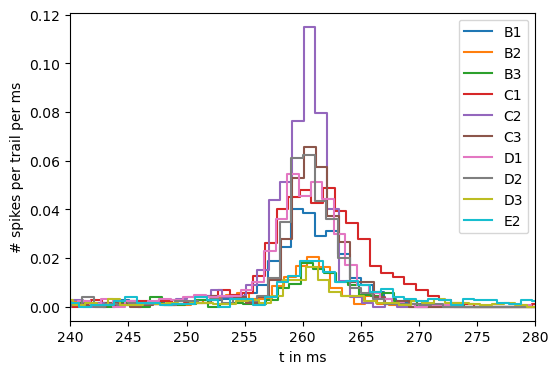

In [ ]:
%matplotlib inline
st = db18k['spike_times']
st['stim'] = st.index.str.split('_').str[0]
st.reset_index(inplace=True)
st.drop('sim_trail_index', axis=1, inplace=True)
st.fillna(I.np.nan, inplace=True)

fig = I.plt.figure(figsize = (6,4))
bins = st.groupby('stim').apply(I.temporal_binning)
for i,v in bins.iteritems(): 
    I.histogram(v, fig = fig, label = i)
fig.axes[-1].set_xlabel('t in ms')
fig.axes[-1].set_ylabel('# spikes per trail per ms')
fig.axes[-1].legend()
fig.axes[-1].set_xlim([240, 280])
